In [1]:
import torch
from imageData import Data
from models import AE
import matplotlib.pyplot as plt
import numpy as np
from statistics import mean
import os
import cv2
from skimage.metrics import peak_signal_noise_ratio as psnr

In [2]:
model = AE()
model.load_state_dict(torch.load('./parameters/model_param.pt'))
model.eval();

In [3]:
train_data = Data('./Data/noised', './Data/original')
val_data = Data('./Data/noised', './Data/original', training = False)

In [4]:
data_path = './Data/original/val'
noised_im_path = './Data/noised/val'
labels = os.listdir(data_path)

In [5]:
ae_psnr = []
bl_psnr = []

for label in labels:
        for image_name in os.listdir(os.path.join(data_path, label)):
            orig_im = cv2.cvtColor(cv2.imread(os.path.join(data_path, label, image_name)), cv2.COLOR_BGR2RGB)
            noised_im = cv2.cvtColor(cv2.imread(os.path.join(noised_im_path, label, image_name)), cv2.COLOR_BGR2RGB)
            
            ae_filtered = model(torch.tensor(noised_im.transpose(2,0,1)).view(1, 3, 256, 256) / 255.0).detach() * 255.0
            ae_filtered = ae_filtered.numpy()[0].transpose(1,2,0).astype(np.uint8())
            ae_psnr.append(psnr(orig_im, ae_filtered))
            
            bl_filtered = cv2.bilateralFilter(noised_im, d=5, sigmaColor=55, sigmaSpace=55)
            bl_psnr.append(psnr(orig_im, bl_filtered))
            

print("AE PSNR:", round(mean(ae_psnr), 2))
print("Bilateral PSNR:", round(mean(bl_psnr), 2))

AE PSNR: 33.36
Bilateral PSNR: 32.07


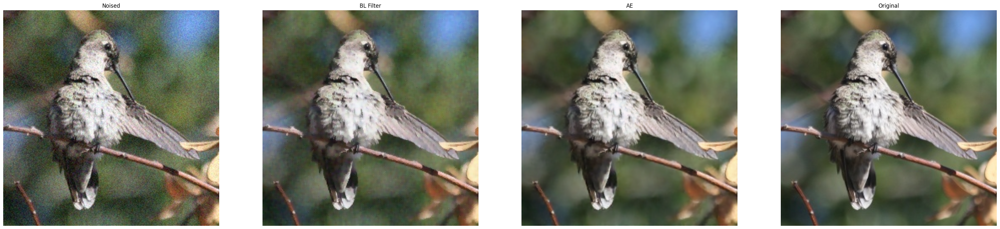

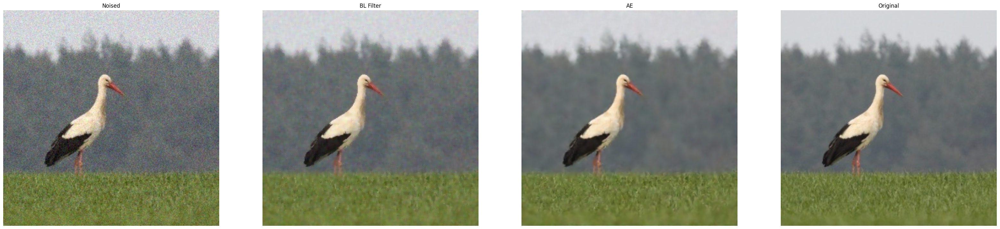

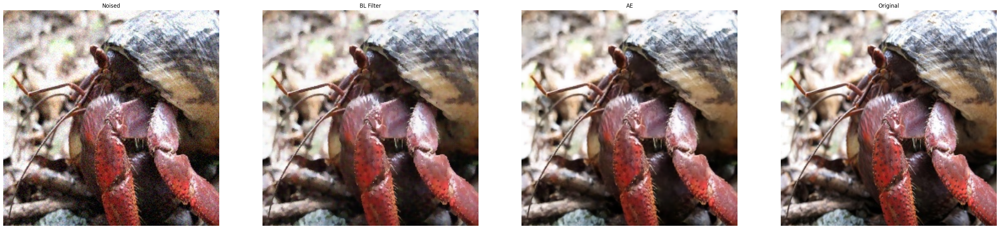

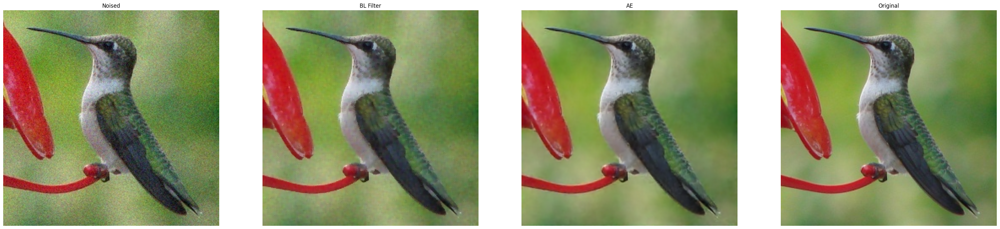

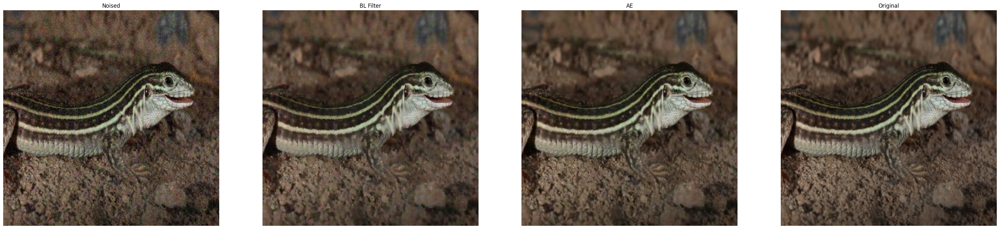

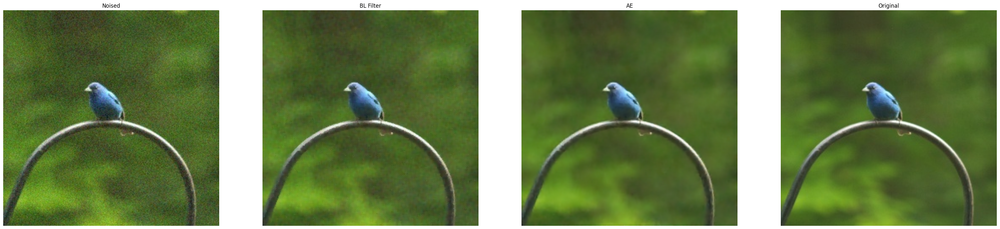

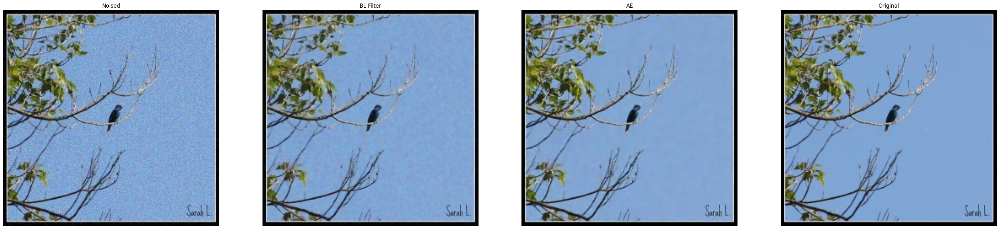

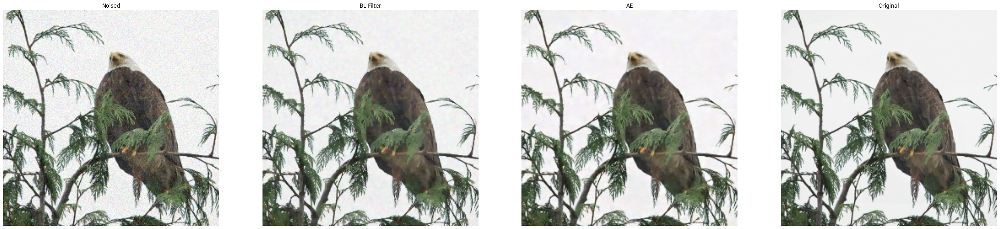

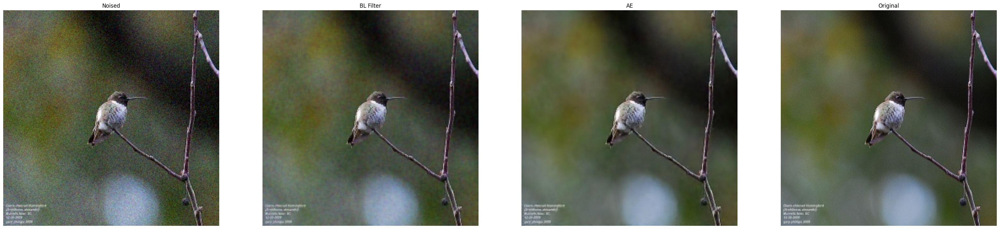

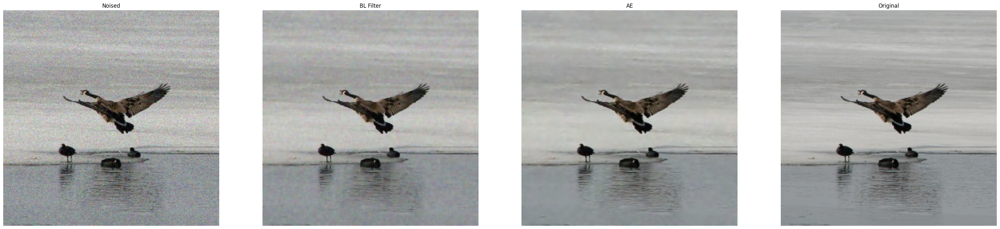

In [6]:
for i in range(10):
    plt.figure(figsize=(40, 10))
    label = labels[np.random.randint(10)]
    im_name = os.listdir(data_path + '/' + label)[np.random.randint(50)]
    orig_im = cv2.cvtColor(cv2.imread(os.path.join(data_path, label, im_name)), cv2.COLOR_BGR2RGB)
    noised_im = cv2.cvtColor(cv2.imread(os.path.join(noised_im_path, label, im_name)), cv2.COLOR_BGR2RGB)
    bl_filtered = cv2.bilateralFilter(noised_im, d=5, sigmaColor=55, sigmaSpace=55)
    ae_filtered = model(torch.tensor(noised_im.transpose(2,0,1)).view(1, 3, 256, 256) / 255.0).detach()
    ae_filtered = ae_filtered.numpy()[0].transpose(1,2,0)
    
    plt.subplot(1, 4, 1);plt.imshow(noised_im);plt.title('Noised');plt.axis('off')
    plt.subplot(1, 4, 2);plt.imshow(bl_filtered);plt.title('BL Filter');plt.axis('off')
    plt.subplot(1, 4, 3);plt.imshow(ae_filtered);plt.title('AE');plt.axis('off')
    plt.subplot(1, 4, 4);plt.imshow(orig_im);plt.title('Original');plt.axis('off')
    plt.savefig(f"results/{i}.png", bbox_inches='tight', pad_inches=0.0);